In [1]:
%load_ext autoreload
%autoreload 2

In [4]:
import numpy as np
import matplotlib.pyplot as plt

import json
from IPython.display import display, HTML
import copy
import os

import torch
import torchvision
import torchvision.transforms as transforms
import torch.nn as nn
from torch.utils.data import Subset

In [5]:
from vit_prisma.models.model_loader import load_hooked_model
import torch.nn as nn

model = load_hooked_model('facebook/dino-vitb16', center_writing_weights=True,
                                        fold_ln=True,
                                        refactor_factored_attn_matrices=True,).to("cpu")

/home/lishuo1/.conda/envs/prisma/lib/python3.11/site-packages/kaleido/__init__.py:14: UserWarning:




This means that static image generation (e.g. `fig.write_image()`) will not work.

Please upgrade Plotly to version 6.1.1 or greater, or downgrade Kaleido to version 0.2.1.




ln_pre not set


Some weights of ViTModel were not initialized from the model checkpoint at facebook/dino-vitb16 and are newly initialized: ['pooler.dense.bias', 'pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
WARNING	root:model_loader.py:fill_missing_keys()- Missing key for weight matrix: head.W_H


LayerNorm folded.
Centered weights writing to residual stream


## Load dataset

In [ ]:
from PIL import Image
from torch.utils.data import Dataset
import pandas as pd
import os

class BindingDataset(Dataset):
    """
    Expects the following directory structure under `root_dir`:
      /images/
        1.png, 2.png, ...
      patch_labels.csv    # columns: image_id, patch_id, object_id, shape, color
      object_labels.csv   # columns: image_id, object_id, shape, color, size, center_x, center_y

    __getitem__ returns:
      image: PIL.Image
      labels: {
        'patch_labels': [
           {'grid_id', 'object_index', 'shape', 'color'}, ...
        ],
        'object_labels': [
           {'object_index', 'shape', 'color', 'size', 'center': (x,y)}, ...
        ]
      }
    """

    def __init__(self, root_dir, transform=None):
        self.root       = root_dir
        # load both CSVs
        self.patch_df   = pd.read_csv(os.path.join(root_dir, "patch_labels.csv"))
        self.obj_df     = pd.read_csv(os.path.join(root_dir, "object_labels.csv"))
        # unique image IDs (numeric)
        self.image_ids  = sorted(self.patch_df["image_id"].unique().tolist())
        self.transform  = transform

    def __len__(self):
        return len(self.image_ids)

    def __getitem__(self, idx):
        # map idx -> image_id -> filename
        image_id   = self.image_ids[idx]
        img_name   = f"{image_id}.png"
        img_path   = os.path.join(self.root, img_name)
        image      = Image.open(img_path).convert("RGB")
        if self.transform:
            image = self.transform(image)

        # --- patch-level labels ---
        patch_rows = self.patch_df[self.patch_df["image_id"] == image_id]
        patch_labels = []
        for _, row in patch_rows.iterrows():
            # fetch size using object_id
            object_index = int(row["object_id"])
            if object_index > 0:
                size = self.obj_df[self.obj_df["image_id"] == image_id][self.obj_df["object_id"] == object_index]["size"].values[0]
                centerx = self.obj_df[self.obj_df["image_id"] == image_id][self.obj_df["object_id"] == object_index]["center_x"].values[0]
                centery = self.obj_df[self.obj_df["image_id"] == image_id][self.obj_df["object_id"] == object_index]["center_y"].values[0]
            else: 
                # for background patches, set to 0
                size = 0
                centerx = 0
                centery = 0
            assert size >= 0, f"Invalid size {size} for object_id {row['object_id']} in image {image_id}"
            patch_labels.append({
                "grid_id"       : int(row["patch_id"]),
                "object_index"  : int(row["object_id"]),
                "shape"         : row["shape"],
                "color"         : row["color"],
                "size"          : size,
                "centerx"       : float(centerx),
                "centery"       : float(centery),
            })

        # --- object-level labels ---
        obj_rows = self.obj_df[self.obj_df["image_id"] == image_id]
        object_labels = []
        for _, row in obj_rows.iterrows():
            object_labels.append({
                "object_index": int(row["object_id"]),
                "shape"       : row["shape"],
                "color"       : row["color"],
                "size"        : int(row["size"]),
                "center"      : (float(row["center_x"]), float(row["center_y"]))
            })

        labels = {
            "patch_labels": patch_labels,
            "object_labels": object_labels
        }
        return image, labels


In [7]:
from torch.utils.data import DataLoader
DEVICE = 'cuda' # change to cpu if cpu only paradigm
BATCH_SIZE = 1000000

In [8]:
from torchvision import transforms

transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=(0.5,0.5,0.5), std=(0.5,0.5,0.5)),
])

data_path = '/home/lishuo1/vision_ood/binding/objects'

train_dataset = BindingDataset(data_path, transform)

In [9]:
from torch.utils.data._utils.collate import default_collate

def binding_collate(batch):
    # batch is a list of (image, labels) pairs
    images, labels = zip(*batch)
    # stack images normally
    images = default_collate(images)
    # leave labels as a tuple (or convert to list) of per-image label lists
    return images, labels  # or `list(labels)`

train_loader = DataLoader(
    train_dataset,
    batch_size=BATCH_SIZE,
    shuffle=False,
    num_workers=8,
    pin_memory=True,
    collate_fn=binding_collate
)

In [10]:
a = next(iter(train_loader))

/tmp/ipykernel_3740664/4165382136.py:54: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

/tmp/ipykernel_3740664/4165382136.py:55: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

/tmp/ipykernel_3740664/4165382136.py:56: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

/tmp/ipykernel_3740664/4165382136.py:54: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

/tmp/ipykernel_3740664/4165382136.py:55: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

/tmp/ipykernel_3740664/4165382136.py:56: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

/tmp/ipykernel_3740664/4165382136.py:54: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

/tmp/ipykernel_3740664/4165382136.py:55: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

/tmp/ipykernel_3740664/4165382136.py:56: UserWar

In [11]:
test_batch = a[0]

In [12]:
test_batch.shape

torch.Size([100, 3, 224, 224])

In [13]:
test_labels = a[1]

In [14]:
all_logits, all_cache = model.run_with_cache(test_batch)

In [15]:
test_labels[99]

{'patch_labels': [{'grid_id': 1,
   'object_index': 0,
   'shape': 'background',
   'color': 'none',
   'size': 0,
   'centerx': 0.0,
   'centery': 0.0,
   'image_id': 100},
  {'grid_id': 2,
   'object_index': 0,
   'shape': 'background',
   'color': 'none',
   'size': 0,
   'centerx': 0.0,
   'centery': 0.0,
   'image_id': 100},
  {'grid_id': 3,
   'object_index': 0,
   'shape': 'background',
   'color': 'none',
   'size': 0,
   'centerx': 0.0,
   'centery': 0.0,
   'image_id': 100},
  {'grid_id': 4,
   'object_index': 0,
   'shape': 'background',
   'color': 'none',
   'size': 0,
   'centerx': 0.0,
   'centery': 0.0,
   'image_id': 100},
  {'grid_id': 5,
   'object_index': 0,
   'shape': 'background',
   'color': 'none',
   'size': 0,
   'centerx': 0.0,
   'centery': 0.0,
   'image_id': 100},
  {'grid_id': 6,
   'object_index': 0,
   'shape': 'background',
   'color': 'none',
   'size': 0,
   'centerx': 0.0,
   'centery': 0.0,
   'image_id': 100},
  {'grid_id': 7,
   'object_index': 

In [16]:
all_logits.shape

torch.Size([100, 768, 2])

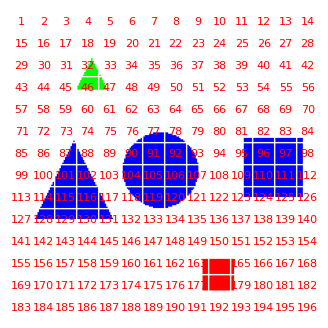

In [17]:
from vit_prisma.visualization.visualize_image import display_grid_on_image
display_grid_on_image(test_batch[99], patch_size=16)

In [18]:
from vit_prisma.utils import prisma_utils

layered_activations = []

for layer in range(model.cfg.n_layers):
    layered_activations.append(all_cache[prisma_utils.get_act_name("resid_mid", layer, None)])

print(len(layered_activations))

12


In [19]:
layered_activations[0].shape

torch.Size([100, 197, 768])

In [20]:
def extract_patch_features(test_labels):
    """
    Extracts per-image patch metadata.

    Args:
        test_labels (list): length-B list of dicts, each with key 'patch_labels',
            where 'patch_labels' is a list of dicts containing at least
            'grid_id', 'shape', 'color', 'size', 'object_index'.

    Returns:
        shapes_per_image (list of list of str)
        colors_per_image (list of list of str)
        sizes_per_image (list of list of float/int)
        objidx_per_image (list of list of int)
        gridids_per_image (list of list of int)
    """
    shapes_per_image = []
    colors_per_image = []
    sizes_per_image = []
    objidx_per_image = []
    gridids_per_image = []
    centerx_per_image = []
    centery_per_image = []

    for img_lbl in test_labels:
        raw = img_lbl.get('patch_labels', [])
        # keep only valid patches
        patches = [p for p in raw if 'grid_id' in p]
        # sort by grid_id to get consistent ordering
        patches = sorted(patches, key=lambda p: p['grid_id'])

        shapes_per_image.append([p['shape'] for p in patches])
        colors_per_image.append([p['color'] for p in patches])
        sizes_per_image.append([p['size'] for p in patches])
        objidx_per_image.append([p['object_index'] for p in patches])
        gridids_per_image.append([p['grid_id'] for p in patches])
        centerx_per_image.append([p['centerx'] for p in patches])
        centery_per_image.append([p['centery'] for p in patches])

    return shapes_per_image, colors_per_image, sizes_per_image, objidx_per_image, gridids_per_image, centerx_per_image, centery_per_image


def extract_flat_patch_labels(test_labels, num_layers):
    """
    Flattens patch metadata across layers for PCA alignment.

    Args:
        test_labels (list): length-B list of dicts with 'patch_labels'.
        num_layers (int): number of layers (e.g. 12).

    Returns:
        flat_shapes          (list of str)   length = num_layers * B * P
        flat_colors          (list of str)
        flat_sizes           (list of float/int)
        flat_object_indices  (list of int)
        flat_grid_ids        (list of int)
        flat_centerx         (list of float)
        flat_centery         (list of float)
    """
    shapes_per_image, colors_per_image, sizes_per_image, objidx_per_image, gridids_per_image, centerx_per_image, centery_per_image = \
        extract_patch_features(test_labels)

    flat_shapes = []
    flat_colors = []
    flat_sizes = []
    flat_object_indices = []
    flat_grid_ids = []
    flat_centerx = []
    flat_centery = []

    for _ in range(num_layers):
        for (shapes, colors, sizes, objidxs, gids, centerxs, centerys) in zip(
            shapes_per_image,
            colors_per_image,
            sizes_per_image,
            objidx_per_image,
            gridids_per_image,
            centerx_per_image,
            centery_per_image
        ):
            flat_shapes.extend(shapes)
            flat_colors.extend(colors)
            flat_sizes.extend(sizes)
            flat_object_indices.extend(objidxs)
            flat_grid_ids.extend(gids)
            flat_centerx.extend(centerxs)
            flat_centery.extend(centerys)

    return flat_shapes, flat_colors, flat_sizes, flat_object_indices, flat_grid_ids, flat_centerx, flat_centery

In [21]:
import os
import numpy as np
from sklearn.decomposition import PCA
import joblib

def fit_layer_pcas(
    layered_activations,
    test_labels,
    max_pcs=20,
    model_dir="pca_models"
):
    """
    Fits PCA separately for each layer and saves the PCA models to disk.

    Args:
        layered_activations: list of L tensors [B, 50, D]
        test_labels: list of length B of dicts with 'patch_labels'
        max_pcs: maximum number of principal components
        model_dir: directory to save fitted PCA models

    Returns:
        pca_data: dict[layer_idx] = {
            'pca': fitted PCA object,
            'X_pca': numpy array [B*P, n_components]
        }
        shapes_flat            (list[str])   length B*P
        colors_flat            (list[str])   length B*P
        sizes_flat             (list[float]) length B*P
        object_indices_flat    (list[int])   length B*P
        grid_ids_flat          (list[int])   length B*P
        centerx_flat           (list[float]) length B*P
        centery_flat           (list[float]) length B*P
    """
    # 1) extract all five metadata sequences per image
    shapes_per_image, \
    colors_per_image, \
    sizes_per_image, \
    objidx_per_image, \
    gridids_per_image, \
    centerx_per_image, \
    centery_per_image = extract_patch_features(test_labels)

    # 2) flatten across images (no layer repeat here)
    shapes_flat         = [s for img in shapes_per_image      for s in img]
    colors_flat         = [c for img in colors_per_image      for c in img]
    sizes_flat          = [z for img in sizes_per_image       for z in img]
    object_indices_flat = [o for img in objidx_per_image      for o in img]
    grid_ids_flat       = [g for img in gridids_per_image     for g in img]
    centerx_flat        = [c for img in centerx_per_image     for c in img]
    centery_flat        = [c for img in centery_per_image     for c in img]

    # prepare output
    os.makedirs(model_dir, exist_ok=True)
    pca_data = {}

    # 3) fit & save PCA per layer
    for layer_idx, layer_act in enumerate(layered_activations):
        # drop CLS, reshape to [B*P, D]
        spatial = layer_act[:, 1:, :].cpu().numpy()  # [B, P, D]
        B, P, D = spatial.shape
        X = spatial.reshape(-1, D) # [B*P, D]

        # fit PCA
        n_comp = min(max_pcs, D)
        pca = PCA(n_components=n_comp)
        X_pca = pca.fit_transform(X)

        # save model
        model_path = os.path.join(model_dir, f"pca_layer_{layer_idx}.joblib")
        joblib.dump(pca, model_path)

        # stash results
        pca_data[layer_idx] = {
            'pca': pca,
            'X_pca': X_pca
        }

    return (
        pca_data,
        shapes_flat,
        colors_flat,
        sizes_flat,
        object_indices_flat,
        grid_ids_flat,
        centerx_flat,
        centery_flat
    )

In [122]:
import os
import numpy as np
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt
import pandas as pd

def plot_pca_results(
    pca_data,
    shapes_flat,
    colors_flat,
    sizes_flat,
    object_indices_flat,
    grid_ids_flat,
    centerx_flat,
    centery_flat,
    outdir="pca_mpl",
    silhouette_mode=False
):
    """
    Generates scree and scatter plots using precomputed PCA results.
    Optionally computes, prints, and saves silhouette scores for shape,
    color, size, object_index, and grid_id clusters across layers.
    
    Args:
        pca_data: dict from fit_layer_pcas()
        shapes_flat: list of length B*P of shape labels
        colors_flat: list of length B*P of color labels
        sizes_flat: list of length B*P of patch sizes
        object_indices_flat: list of length B*P of object_index labels
        grid_ids_flat: list of length B*P of grid_id integers
        centerx_flat: list of length B*P of centerx coordinates
        centery_flat: list of length B*P of centery coordinates
        outdir: root directory to save plots
        silhouette_mode: if True, compute and plot silhouette scores across layers
    """
    os.makedirs(outdir, exist_ok=True)
    
    # Encode labels for silhouette
    unique_shapes = sorted(set(shapes_flat))
    shape_labels = np.array([unique_shapes.index(s) for s in shapes_flat])

    unique_colors = sorted(set(colors_flat))
    color_labels = np.array([unique_colors.index(c) for c in colors_flat])

    sizes_arr = np.array(sizes_flat, dtype=float)
    # ——— Bin sizes into 5 quantile-based categories ———
    size_cat = pd.cut(sizes_arr, bins=5, labels=False, include_lowest=True)

    grid_arr = np.array(grid_ids_flat)
    # ——— Bin grid IDs into 5 quantile-based categories ———
    grid_cat = pd.cut(grid_arr, bins=5, labels=False, include_lowest=True)

    unique_objidx = sorted(set(object_indices_flat))
    objidx_to_int = {oi: idx for idx, oi in enumerate(unique_objidx)}
    object_labels = np.array([objidx_to_int[oi] for oi in object_indices_flat])

    shape_scores, color_scores, size_scores, grid_scores, object_scores = [], [], [], [], []

    for layer_idx, data in pca_data.items():
        X_pca = data['X_pca']
        
        # Silhouette scores on PC1/PC2/PC3
        if silhouette_mode:
            ss = silhouette_score(X_pca[:, :3], shape_labels) if len(set(shape_labels))>1 else np.nan
            sc = silhouette_score(X_pca[:, :3], color_labels) if len(set(color_labels))>1 else np.nan
            sis = silhouette_score(X_pca[:, :3], size_cat) if len(set(size_cat))>1 else np.nan
            gs = silhouette_score(X_pca[:, :3], grid_cat) if len(set(grid_cat))>1 else np.nan
            objs = silhouette_score(X_pca[:, :3], object_labels) if len(set(object_labels))>1 else np.nan
            print(f"Layer {layer_idx}: silhouette_shape={ss:.4f}, silhouette_color={sc:.4f}, silhouette_size={sis:.4f}, silhouette_grid={gs:.4f}, silhouette_object={objs:.4f}")
            shape_scores.append(ss)
            color_scores.append(sc)
            size_scores.append(sis)
            grid_scores.append(gs)
            object_scores.append(objs)

        layer_dir = os.path.join(outdir, f"layer_{layer_idx}")
        os.makedirs(layer_dir, exist_ok=True)

        # Scree
        pca = data['pca']
        n_comp = X_pca.shape[1]
        plt.figure()
        plt.plot(np.arange(1, n_comp+1), pca.explained_variance_ratio_, '-o')
        plt.title(f'Layer {layer_idx}: Scree Plot')
        plt.xlabel('PC')
        plt.ylabel('Explained Variance Ratio')
        plt.xticks(np.arange(1, n_comp+1))
        plt.tight_layout()
        plt.savefig(os.path.join(layer_dir, 'scree.png'))
        plt.close()

        # Scatter by shape
        fig, ax = plt.subplots()
        cmap = plt.get_cmap('tab10')
        for i, s in enumerate(unique_shapes):
            idxs = [j for j, sh in enumerate(shapes_flat) if sh==s]
            ax.scatter(X_pca[idxs,0], X_pca[idxs,1], c=[cmap(i)], label=s, alpha=0.6)
        ax.set_title(f'Layer {layer_idx}: PC1 vs PC2 by Shape')
        ax.set_xlabel('PC1'); ax.set_ylabel('PC2')
        ax.legend(markerscale=1.5, fontsize='small', loc='best')
        plt.tight_layout()
        plt.savefig(os.path.join(layer_dir, 'scatter_shape.png'))
        plt.close()

        # Scatter by color
        fig, ax = plt.subplots()
        for i, c in enumerate(unique_colors):
            idxs = [j for j, col in enumerate(colors_flat) if col==c]
            plot_col = 'dimgray' if c.lower()=='none' else c
            ax.scatter(X_pca[idxs,0], X_pca[idxs,1], c=[plot_col], label=c, alpha=0.6)
        ax.set_title(f'Layer {layer_idx}: PC1 vs PC2 by Color')
        ax.set_xlabel('PC1'); ax.set_ylabel('PC2')
        ax.legend(markerscale=1.5, fontsize='small', loc='best')
        plt.tight_layout()
        plt.savefig(os.path.join(layer_dir, 'scatter_color.png'))
        plt.close()

        # Scatter by object index (discrete colors)
        fig, ax = plt.subplots()
        cmap2 = plt.get_cmap('tab20')
        for oi, oi_val in enumerate(unique_objidx):
            idxs = [j for j, obj in enumerate(object_indices_flat) if obj==oi_val]
            ax.scatter(X_pca[idxs,0], X_pca[idxs,1], c=[cmap2(oi % 20)], label=str(oi_val), s=30, alpha=0.6)
        ax.set_title(f'Layer {layer_idx}: PC1 vs PC2 by Object Index')
        ax.set_xlabel('PC1'); ax.set_ylabel('PC2')
        ax.legend(markerscale=1.5, fontsize='small', loc='best')
        plt.tight_layout()
        plt.savefig(os.path.join(layer_dir, 'scatter_object_index.png'))
        plt.close()

        # Scatter by grid_id (continuous color)
        fig, ax = plt.subplots()
        sc = ax.scatter(X_pca[:,0], X_pca[:,1], c=grid_arr, cmap='viridis', s=30, alpha=0.7)
        fig.colorbar(sc, ax=ax, label='Grid ID')
        ax.set_title(f'Layer {layer_idx}: PC1 vs PC2 by Grid ID')
        ax.set_xlabel('PC1'); ax.set_ylabel('PC2')
        plt.tight_layout()
        plt.savefig(os.path.join(layer_dir, 'scatter_grid_id.png'))
        plt.close()

        # — Scatter by size (continuous color + size) —
        fig, ax = plt.subplots()
        sc = ax.scatter(
            X_pca[:,0], X_pca[:,1],
            c=sizes_arr,                    # raw continuous sizes
            cmap='plasma',                  # any matplotlib continuous cmap
            alpha=0.7,
        )
        cbar = fig.colorbar(sc, ax=ax)
        cbar.set_label('Patch size')
        ax.set_title(f'Layer {layer_idx}: PC1 vs PC2 by Size')
        ax.set_xlabel('PC1'); ax.set_ylabel('PC2')
        plt.tight_layout()
        plt.savefig(os.path.join(layer_dir, 'scatter_size.png'))
        plt.close()

        # — Scatter by center_x coordinate —
        fig, ax = plt.subplots()
        sc = ax.scatter(
            X_pca[:,0], X_pca[:,1],
            s=30,
            c=centerx_flat,
            cmap='viridis',
            alpha=0.7,
        )
        fig.colorbar(sc, ax=ax, label='Center X')
        ax.set_title(f'Layer {layer_idx}: PC1 vs PC2 colored by center_x')
        ax.set_xlabel('PC1'); ax.set_ylabel('PC2')
        plt.tight_layout()
        plt.savefig(os.path.join(layer_dir, 'scatter_centerx.png'))
        plt.close()

        # — Scatter by center_y coordinate —
        fig, ax = plt.subplots()
        sc = ax.scatter(
            X_pca[:,0], X_pca[:,1],
            s=30,
            c=centery_flat,
            cmap='cividis',
            alpha=0.7,
        )
        fig.colorbar(sc, ax=ax, label='Center Y')
        ax.set_title(f'Layer {layer_idx}: PC1 vs PC2 colored by center_y')
        ax.set_xlabel('PC1'); ax.set_ylabel('PC2')
        plt.tight_layout()
        plt.savefig(os.path.join(layer_dir, 'scatter_centery.png'))
        plt.close()

        # Save metadata CSV
        df_meta = pd.DataFrame({
            'shape': shapes_flat,
            'color': colors_flat,
            'size': sizes_flat,
            'object_index': object_indices_flat,
            'grid_id': grid_ids_flat
        })
        df_meta.to_csv(os.path.join(layer_dir, 'metadata.csv'), index=False)

    # Silhouette summary
    if silhouette_mode:
        layers = list(pca_data.keys())
        all_scores = [s for s in shape_scores + color_scores + size_scores + grid_scores + object_scores if not np.isnan(s)]
        ymin, ymax = min(all_scores), max(all_scores)
        margin = (ymax - ymin)*0.05 if ymax>ymin else 0.05
        plt.figure(figsize=(8,4))
        plt.plot(layers, shape_scores, marker='o', label='shape silhouette')
        plt.plot(layers, color_scores, marker='s', label='color silhouette')
        plt.plot(layers, size_scores, marker='^', label='size silhouette')
        plt.plot(layers, grid_scores, marker='x', label='grid_id silhouette')
        plt.plot(layers, object_scores, marker='d', label='object_index silhouette')
        plt.xlabel('Layer Index'); plt.ylabel('Silhouette Score')
        plt.title('Silhouette Score by Layer')
        plt.xticks(layers); plt.ylim(ymin-margin, ymax+margin)
        plt.grid(True); plt.legend()
        plt.tight_layout()
        plt.savefig(os.path.join(outdir, 'silhouette_by_layer.png'))
        plt.close()

In [241]:
num_objects_flat = []
for img_lbl in test_labels:
    # count how many objects (add +1 if you want to count background as an "object")
    n_obj = len(img_lbl['object_labels'])
    # OR, if you want to include background:  n_obj = len(img_lbl['object_labels']) + 1
    # for each patch in that image, append the same count
    patches = [p for p in img_lbl['patch_labels'] if 'grid_id' in p]
    # (optionally sort by grid_id if you do elsewhere)
    for _ in patches:
        num_objects_flat.append(n_obj)

In [242]:
len(num_objects_flat)

19600

In [ ]:
import os
import math
import numpy as np
import matplotlib.pyplot as plt

# for 3D plotting
from mpl_toolkits.mplot3d import Axes3D  # noqa: F401

def plot_pca_results_combined(
    pca_data,
    shapes_flat,
    colors_flat,
    sizes_flat,
    object_indices_flat,
    grid_ids_flat,
    centerx_flat,
    centery_flat,
    outdir="pca_mpl",
    silhouette_mode=False,
    plot_3d=False
):
    """
    Generates combined PC1–PC2 (and optionally PC1–PC2–PC3) scatter plots for each feature across all layers,
    with edge-only labels, unified legends/colorbars, transparent datapoints, and tight layout.

    Args:
        pca_data: dict[layer_idx] -> {'X_pca': ndarray, ...}
        shapes_flat, colors_flat, sizes_flat, object_indices_flat, grid_ids_flat, centerx_flat, centery_flat: label arrays
        outdir: directory to save figures
        silhouette_mode: if True, compute silhouette (NOT implemented here)
        plot_3d: if True, also plot top 3 PCs in 3D for each feature
    """
    os.makedirs(outdir, exist_ok=True)

    def encode_labels(values):
        uniq = sorted(set(values))
        return np.array([uniq.index(v) for v in values]), uniq

    # Encode feature labels
    shape_vals, unique_shapes = encode_labels(shapes_flat)
    color_vals, unique_colors = encode_labels(colors_flat)
    obj_vals, unique_objidx = encode_labels(object_indices_flat)
    size_vals = np.array(sizes_flat, dtype=float)
    grid_vals = np.array(grid_ids_flat, dtype=float)
    cx_vals   = np.array(centerx_flat, dtype=float)
    cy_vals   = np.array(centery_flat, dtype=float)

    features = [
        ("shape",      shape_vals,      "tab10",   unique_shapes),
        ("color",      color_vals,      None,       unique_colors),
        ("object_idx", obj_vals,        "tab20",   unique_objidx),
        ("grid_id",    grid_vals,       "viridis", None),
        ("size",       size_vals,       "plasma",  None),
        ("center_x",   cx_vals,         "viridis", None),
        ("center_y",   cy_vals,         "viridis", None),
    ]

    layers = list(pca_data.keys())
    L = len(layers)
    ncols = math.ceil(math.sqrt(L))
    nrows = math.ceil(L / ncols)

    for feat_name, feat_vals, cmap, uniq_vals in features:
        # 2D combined plot
        fig, axes = plt.subplots(
            nrows, ncols,
            figsize=(4 * ncols, 4 * nrows),
            sharex=True, sharey=True
        )
        axes = axes.flatten()
        for i, layer_idx in enumerate(layers):
            ax = axes[i]
            X2 = pca_data[layer_idx]['X_pca'][:, :2]

            if uniq_vals is not None:
                for k, label in enumerate(uniq_vals):
                    idxs = np.where(feat_vals == k)[0]
                    if feat_name == "color":
                        col = label if str(label).lower() != 'none' else 'dimgray'
                    else:
                        col = plt.get_cmap(cmap)(k % plt.get_cmap(cmap).N)
                    ax.scatter(X2[idxs,0], X2[idxs,1], c=[col], s=30, alpha=0.3)
            else:
                sc = ax.scatter(X2[:,0], X2[:,1], c=feat_vals, cmap=cmap, s=30, alpha=0.3)

            if i % ncols == 0:
                ax.set_ylabel("PC2")
            if i >= L - ncols:
                ax.set_xlabel("PC1")
            ax.set_title(f"Layer {layer_idx}")

        # disable any unused subplots
        for j in range(L, len(axes)):
            axes[j].axis('off')

        # adjust layout to make room for colorbar/legend
        fig.tight_layout()
        fig.subplots_adjust(right=0.92)

        if uniq_vals is not None:
            # unified legend
            handles = []
            for k, label in enumerate(uniq_vals):
                if feat_name == "color":
                    col = label if str(label).lower() != 'none' else 'dimgray'
                else:
                    col = plt.get_cmap(cmap)(k % plt.get_cmap(cmap).N)
                handles.append(plt.Line2D([], [], marker='o', linestyle='', color=col, alpha=0.3, label=str(label)))
            fig.legend(
                handles=handles,
                loc='upper right',
                bbox_to_anchor=(1.0, 1.0),
                title=feat_name.replace('_', ' '),
                fontsize='small'
            )
        else:
            # unified colorbar on right
            cbar = fig.colorbar(
                sc,
                ax=axes.tolist(),
                orientation='vertical',
                fraction=0.02,
                pad=0.03,
                label=feat_name.replace('_', ' ')
            )

        fig.savefig(os.path.join(outdir, f"combined_scatter_{feat_name}_2d.png"))
        plt.close(fig)

        # 3D combined plot
        if plot_3d:
            fig3d = plt.figure(figsize=(4 * ncols, 4 * nrows))
            axes3d = []
            for idx in range(L):
                ax3 = fig3d.add_subplot(nrows, ncols, idx+1, projection='3d')
                axes3d.append(ax3)

            for i, layer_idx in enumerate(layers):
                ax3 = axes3d[i]
                X3 = pca_data[layer_idx]['X_pca'][:, :3]
                if uniq_vals is not None:
                    for k, label in enumerate(uniq_vals):
                        idxs = np.where(feat_vals == k)[0]
                        if feat_name == "color":
                            col = label if str(label).lower() != 'none' else 'dimgray'
                        else:
                            col = plt.get_cmap(cmap)(k % plt.get_cmap(cmap).N)
                        ax3.scatter(X3[idxs,0], X3[idxs,1], X3[idxs,2], c=[col], s=30, alpha=0.3)
                else:
                    sc3 = ax3.scatter(X3[:,0], X3[:,1], X3[:,2], c=feat_vals, cmap=cmap, s=30, alpha=0.3)

                if i % ncols == 0:
                    ax3.set_ylabel("PC2")
                if i >= L - ncols:
                    ax3.set_xlabel("PC1")
                ax3.set_zlabel("PC3")
                ax3.set_title(f"Layer {layer_idx}")

            for j in range(L, len(axes3d)):
                axes3d[j].axis('off')

            fig3d.tight_layout()
            fig3d.subplots_adjust(right=0.92)

            if uniq_vals is not None:
                fig3d.legend(
                    handles=handles,
                    loc='upper right',
                    bbox_to_anchor=(1.0, 1.0),
                    title=feat_name.replace('_', ' '),
                    fontsize='small'
                )
            else:
                cbar3 = fig3d.colorbar(
                    sc3,
                    ax=axes3d,
                    orientation='vertical',
                    fraction=0.02,
                    pad=0.03,
                    label=feat_name.replace('_', ' ')
                )

            fig3d.savefig(os.path.join(outdir, f"combined_scatter_{feat_name}_3d.png"))
            plt.close(fig3d)


In [27]:
pca_data,shapes_flat,colors_flat,sizes_flat,object_indices_flat,grid_ids_flat,centerx_flat,centery_flat = fit_layer_pcas(layered_activations, test_labels, max_pcs=20)

In [ ]:
# Some BS about Kernel PCA without using embeddings

In [ ]:
# import numpy as np
# from sklearn.decomposition import KernelPCA
# from scipy.linalg import subspace_angles

# # assume you’ve already got:
# #   embeddings: list of length L, each an (N×D) array of patch embeddings
# #   object_indices_flat: length-N list/array of object IDs
# #   colors_flat: length-N list/array of color labels

# # 1) build the N×N “same-object” and “same-color” kernels
# object_labels = np.array(object_indices_flat)
# color_labels  = np.array(colors_flat)

# K_obj   = (object_labels[:, None] == object_labels[None, :]).astype(float)
# K_color = (color_labels[:,   None] == color_labels[None,   :]).astype(float)

# # 2) choose number of subspace components
# #    for object IDs you have up to 5 distinct slots:
# n_obj_comp   = min(10, len(np.unique(object_labels)))
# #    for color, choose number of unique colors minus 1 (or cap it)
# n_color_comp = min(len(np.unique(color_labels)), n_obj_comp)

# # 3) run KernelPCA with precomputed kernels
# kpca_obj = KernelPCA(kernel='precomputed', n_components=n_obj_comp)
# Phi_obj  = kpca_obj.fit_transform(K_obj)       # shape (N, n_obj_comp)

# kpca_col = KernelPCA(kernel='precomputed', n_components=n_color_comp)
# Phi_col  = kpca_col.fit_transform(K_color)     # shape (N, n_color_comp)

# # 4) compute principal angles between the two subspaces
# #    subspace_angles returns an array of angles (in radians)
# angles = subspace_angles(Phi_obj, Phi_col)

# print("Principal angles (radians) between object-ID and color subspaces:")
# for i, ang in enumerate(angles, 1):
#     print(f"  angle {i}: {ang:.4f} rad  ({np.degrees(ang):.1f}°)")  

Principal angles (radians) between object-ID and color subspaces:
  angle 1: 1.5480 rad  (88.7°)
  angle 2: 1.4825 rad  (84.9°)
  angle 3: 1.4111 rad  (80.8°)
  angle 4: 1.3716 rad  (78.6°)
  angle 5: 0.0000 rad  (0.0°)


In [ ]:
# object count, normalized object index (neither works)

In [ ]:
# import os
# import math
# import numpy as np
# import matplotlib.pyplot as plt
# from mpl_toolkits.mplot3d import Axes3D  # noqa: F401

# def plot_pca_results_combined(
#     pca_data,
#     shapes_flat,
#     colors_flat,
#     sizes_flat,
#     object_indices_flat,
#     num_objects_flat,
#     grid_ids_flat,
#     centerx_flat,
#     centery_flat,
#     outdir="pca_mpl",
#     silhouette_mode=False,
#     plot_3d=False
# ):
#     """
#     Combined PC1–PC2 (and optional PC1–PC2–PC3) scatter plots for each feature across all layers.
#     Shared legends/colorbars on right, transparent points (alpha=0.3), tight layout.
#     """
#     os.makedirs(outdir, exist_ok=True)

#     # helper to encode categorical labels
#     def encode_labels(values):
#         uniq = sorted(set(values))
#         return np.array([uniq.index(v) for v in values]), uniq

#     # encode categorical features
#     shape_vals, unique_shapes = encode_labels(shapes_flat)
#     color_vals, unique_colors = encode_labels(colors_flat)
#     obj_idx_arr   = np.array(object_indices_flat, dtype=float)
#     obj_count_arr = np.array(num_objects_flat,  dtype=float)
#     obj_frac_vals = obj_idx_arr / obj_count_arr
#     size_vals     = np.array(sizes_flat,        dtype=float)
#     grid_vals     = np.array(grid_ids_flat,     dtype=float)
#     cx_vals       = np.array(centerx_flat,      dtype=float)
#     cy_vals       = np.array(centery_flat,      dtype=float)

#     features = [
#         # ("shape",           shape_vals,      "tab10",  unique_shapes),
#         # ("color",           color_vals,      None,     unique_colors),
#         ("object_count", obj_count_arr,   "plasma", None),
#         # ("grid_id",         grid_vals,       "viridis",None),
#         # ("size",            size_vals,       "plasma", None),
#         # ("center_x",        cx_vals,         "viridis",None),
#         # ("center_y",        cy_vals,         "cividis",None),
#     ]

#     layers = list(pca_data.keys())
#     L      = len(layers)
#     ncols  = math.ceil(math.sqrt(L))
#     nrows  = math.ceil(L / ncols)

#     for feat_name, feat_vals, cmap, uniq_vals in features:
#         # 2D scatter grid
#         fig, axes = plt.subplots(
#             nrows, ncols,
#             figsize=(4 * ncols, 4 * nrows),
#             sharex=True, sharey=True
#         )
#         axes = axes.flatten()

#         for i, layer_idx in enumerate(layers):
#             ax = axes[i]
#             X2 = pca_data[layer_idx]['X_pca'][:, :2]

#             if uniq_vals is not None:
#                 # categorical
#                 for k, label in enumerate(uniq_vals):
#                     idxs = np.where(feat_vals == k)[0]
#                     if feat_name == "color":
#                         col = label if str(label).lower() != 'none' else 'dimgray'
#                     else:
#                         col = plt.get_cmap(cmap)(k % plt.get_cmap(cmap).N)
#                     ax.scatter(X2[idxs,0], X2[idxs,1], c=[col], s=30, alpha=0.3)
#             else:
#                 # continuous
#                 sc = ax.scatter(X2[:,0], X2[:,1], c=feat_vals, cmap=cmap, s=30, alpha=0.3)

#             # only label outer axes
#             if i % ncols == 0:
#                 ax.set_ylabel("PC2")
#             if i >= L - ncols:
#                 ax.set_xlabel("PC1")
#             ax.set_title(f"Layer {layer_idx}")

#         # hide any extra subplots
#         for j in range(L, len(axes)):
#             axes[j].axis('off')

#         # layout & reserve right margin for legend/colorbar
#         fig.tight_layout()
#         fig.subplots_adjust(right=0.90)

#         if uniq_vals is not None:
#             # shared legend
#             handles = []
#             for k, label in enumerate(uniq_vals):
#                 if feat_name == "color":
#                     col = label if str(label).lower() != 'none' else 'dimgray'
#                 else:
#                     col = plt.get_cmap(cmap)(k % plt.get_cmap(cmap).N)
#                 handles.append(
#                     plt.Line2D([], [], marker='o', linestyle='',
#                                color=col, alpha=0.3, label=str(label))
#                 )
#             fig.legend(
#                 handles=handles,
#                 loc='upper right',
#                 bbox_to_anchor=(0.95, 0.95),
#                 title=feat_name.replace('_',' '),
#                 fontsize='small'
#             )
#         else:
#             # shared colorbar
#             fig.colorbar(
#                 sc,
#                 ax=axes,
#                 orientation='vertical',
#                 fraction=0.02,
#                 pad=0.03,
#                 label=feat_name.replace('_',' ')
#             )

#         fig.savefig(os.path.join(outdir, f"combined_scatter_{feat_name}_2d.png"))
#         plt.close(fig)

#         # 3D scatter (optional)
#         if plot_3d:
#             fig3d = plt.figure(figsize=(4 * ncols, 4 * nrows))
#             axes3d = [
#                 fig3d.add_subplot(nrows, ncols, idx+1, projection='3d')
#                 for idx in range(L)
#             ]

#             for i, layer_idx in enumerate(layers):
#                 ax3 = axes3d[i]
#                 X3 = pca_data[layer_idx]['X_pca'][:, :3]

#                 if uniq_vals is not None:
#                     for k, label in enumerate(uniq_vals):
#                         idxs = np.where(feat_vals == k)[0]
#                         if feat_name == "color":
#                             col = label if str(label).lower() != 'none' else 'dimgray'
#                         else:
#                             col = plt.get_cmap(cmap)(k % plt.get_cmap(cmap).N)
#                         ax3.scatter(X3[idxs,0], X3[idxs,1], X3[idxs,2],
#                                     c=[col], s=30, alpha=0.3)
#                 else:
#                     sc3 = ax3.scatter(
#                         X3[:,0], X3[:,1], X3[:,2],
#                         c=feat_vals, cmap=cmap, s=30, alpha=0.3
#                     )

#                 if i % ncols == 0:
#                     ax3.set_ylabel("PC2")
#                 if i >= L - ncols:
#                     ax3.set_xlabel("PC1")
#                 ax3.set_zlabel("PC3")
#                 ax3.set_title(f"Layer {layer_idx}")

#             for j in range(L, len(axes3d)):
#                 axes3d[j].axis('off')

#             fig3d.tight_layout()
#             fig3d.subplots_adjust(right=0.90)

#             if uniq_vals is not None:
#                 fig3d.legend(
#                     handles=handles,
#                     loc='upper right',
#                     bbox_to_anchor=(0.95, 0.95),
#                     title=feat_name.replace('_',' '),
#                     fontsize='small'
#                 )
#             else:
#                 fig3d.colorbar(
#                     sc3,
#                     ax=axes3d,
#                     orientation='vertical',
#                     fraction=0.02,
#                     pad=0.03,
#                     label=feat_name.replace('_',' ')
#                 )

#             fig3d.savefig(os.path.join(outdir, f"combined_scatter_{feat_name}_3d.png"))
#             plt.close(fig3d)


In [ ]:
# num_objects_flat = []
# for img_lbl in test_labels:
#     # count how many objects (add +1 if you want to count background as an "object")
#     n_obj = len(img_lbl['object_labels'])
#     # OR, if you want to include background:  n_obj = len(img_lbl['object_labels']) + 1

#     # for each patch in that image, append the same count
#     patches = [p for p in img_lbl['patch_labels'] if 'grid_id' in p]
#     # (optionally sort by grid_id if you do elsewhere)
#     for _ in patches:
#         num_objects_flat.append(n_obj)

In [ ]:
# save_pca_mpl = plot_pca_results_combined(pca_data,shapes_flat,colors_flat,sizes_flat,object_indices_flat,num_objects_flat,grid_ids_flat,centerx_flat,centery_flat, outdir='pca_mpl_sil_all_dino', silhouette_mode=False, plot_3d=True)
# silhouette_mode makes it slow

In [ ]:
save_pca_mpl = plot_pca_results_combined(pca_data,shapes_flat,colors_flat,sizes_flat,object_indices_flat,grid_ids_flat,centerx_flat,centery_flat, outdir='pca_mpl_sil_all_dino', silhouette_mode=False, plot_3d=True)
# silhouette_mode makes it slow

Linear Probes

In [263]:
embeddings = []
for act in layered_activations:
    embeddings.append(np.concatenate(act[:, 1:, :].cpu().numpy(), axis=0))  # drop CLS token

In [ ]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.linear_model import LogisticRegression, LinearRegression
from sklearn.metrics import accuracy_score, r2_score
from collections import Counter

# Prepare label arrays
y_shapes     = np.array(shapes_flat)
y_colors     = np.array(colors_flat)
y_sizes      = np.array(sizes_flat,   dtype=float)
y_obj_idx    = np.array(object_indices_flat, dtype=int)
y_grid_ids   = np.array(grid_ids_flat, dtype=int)
y_centerx    = np.array(centerx_flat, dtype=float)
y_centery    = np.array(centery_flat, dtype=float)

tasks = {
    'shape':        ('classification', y_shapes),
    'color':        ('classification', y_colors),
    'size':         ('regression',     y_sizes),
    'object_index': ('classification', y_obj_idx),
    'grid_id':      ('regression',     y_grid_ids),
    'center_x':     ('regression',     y_centerx),
    'center_y':     ('regression',     y_centery),
}

results = []

for layer_idx, X in enumerate(embeddings):
    scaler   = StandardScaler().fit(X)
    X_scaled = scaler.transform(X)
    
    for label_name, (task_type, y) in tasks.items():
        X_train, X_test, y_train, y_test = train_test_split(
            X_scaled, y, test_size=0.2, random_state=0
        )
        
        # --- compute baseline ---
        if task_type == 'classification':
            # majority‐class from training set
            most_common, _ = Counter(y_train).most_common(1)[0]
            y_test_baseline = np.full_like(y_test, fill_value=most_common)
            baseline_score = accuracy_score(y_test, y_test_baseline)
            baseline_metric = 'baseline_accuracy'
        else:
            # constant predictor = training mean
            mean_val   = y_train.mean()
            y_test_baseline = np.full_like(y_test, fill_value=mean_val)
            baseline_score = r2_score(y_test, y_test_baseline)
            baseline_metric = 'baseline_r2'
        
        print(f"Layer {layer_idx} | {label_name:12s} | {baseline_metric}: {baseline_score:.4f}")

        # --- fit actual model ---
        if task_type == 'classification':
            le = LabelEncoder().fit(y_train)
            y_train_enc = le.transform(y_train)
            y_test_enc  = le.transform(y_test)
            
            clf   = LogisticRegression(
                max_iter=1000,
                solver='lbfgs'
            ).fit(X_train, y_train_enc)
            y_pred     = clf.predict(X_test)
            score      = accuracy_score(y_test_enc, y_pred)
            metric     = 'accuracy'
        else:
            reg    = LinearRegression().fit(X_train, y_train)
            y_pred = reg.predict(X_test)
            score  = r2_score(y_test, y_pred)
            metric = 'r2'
        
        print(f"Layer {layer_idx} | {label_name:12s} | {metric}: {score:.4f}")

        # --- record both baseline and model ---
        results.append({
            'layer':          layer_idx,
            'label':          label_name,
            'task':           task_type,
            'metric':         metric,
            'score':          score,
            'baseline_metric': baseline_metric,
            'baseline_score': baseline_score
        })

# Compile into DataFrame
df_results = pd.DataFrame(results)
df_results.head()

KeyboardInterrupt: 

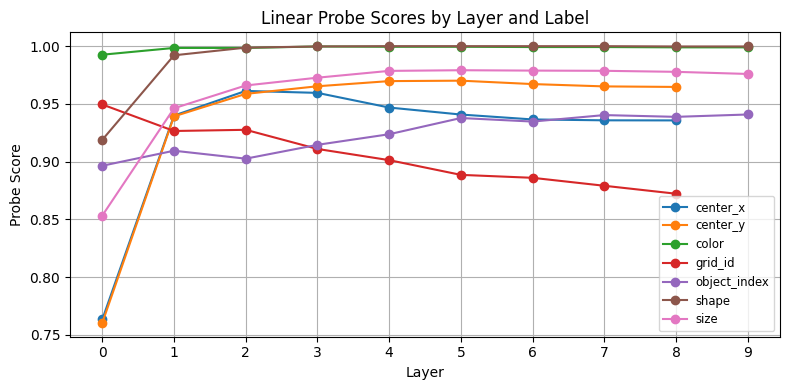

In [270]:
import matplotlib.pyplot as plt

# Pivot the results: rows=layers, columns=labels, values=score
pivot = df_results.pivot(index='layer', columns='label', values='score')

plt.figure(figsize=(8, 4))
for label in pivot.columns:
    plt.plot(pivot.index, pivot[label], marker='o', linestyle='-')
plt.xticks(pivot.index)
plt.xlabel("Layer")
plt.ylabel("Probe Score")
plt.title("Linear Probe Scores by Layer and Label")
plt.legend(pivot.columns, fontsize='small', loc='best')
plt.grid(True)
plt.tight_layout()
plt.show()


Layer AUC: 0.9872 (N=19600, M=19600)
Layer AUC: 0.9853 (N=19600, M=19600)
Layer AUC: 0.9911 (N=19600, M=19600)
Layer AUC: 0.9956 (N=19600, M=19600)
Layer AUC: 0.9956 (N=19600, M=19600)
Layer AUC: 0.9962 (N=19600, M=19600)
Layer AUC: 0.9954 (N=19600, M=19600)
Layer AUC: 0.9946 (N=19600, M=19600)
Layer AUC: 0.9940 (N=19600, M=19600)
Layer AUC: 0.9945 (N=19600, M=19600)
Layer AUC: 0.9944 (N=19600, M=19600)
Layer AUC: 0.9932 (N=19600, M=19600)


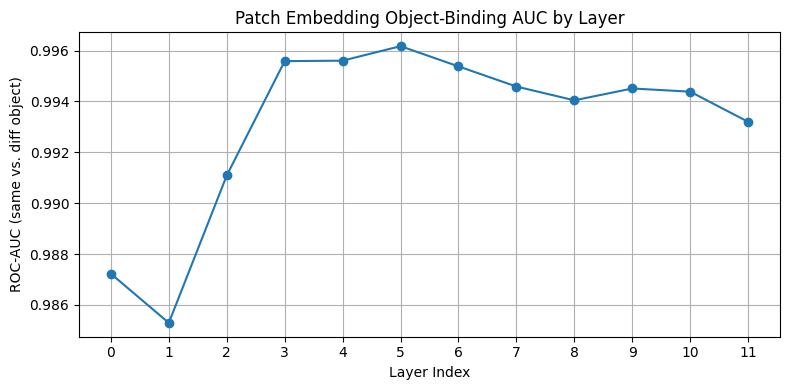

In [ ]:
embeddings = []
for act in layered_activations:
    embeddings.append(np.concatenate(act[:, 1:, :].cpu().numpy(), axis=0))  # drop CLS token
object_labels = np.array(object_indices_flat)

import numpy as np
from sklearn.metrics import roc_auc_score

def compute_layer_auc(E, object_labels, M=19600, random_state=None):
    """
    E:    (N×D) embedding array for one layer
    object_labels: length-N array of ints
    M:    number of random pairs to sample (default 2000)
    """
    N, D = E.shape
    rng = np.random.default_rng(random_state)

    # 2) sample M random index‐pairs (i,j) with i < j
    #    generate 2*M random indices and then filter i<j until we have M pairs
    i_idxs = []
    j_idxs = []
    while len(i_idxs) < M:
        i = rng.integers(0, N, size=M)
        j = rng.integers(0, N, size=M)
        mask = (i < j)
        i_idxs.extend(i[mask].tolist())
        j_idxs.extend(j[mask].tolist())
    i_idxs = np.array(i_idxs[:M])
    j_idxs = np.array(j_idxs[:M])

    # 3) compute cosine similarity only for those M pairs
    dots = np.einsum('ij,ij->i', E[i_idxs], E[j_idxs])           # shape (M,)
    norms_i = np.linalg.norm(E[i_idxs], axis=1)  # shape (M,)
    norms_j = np.linalg.norm(E[j_idxs], axis=1)  # shape (M,)
    sims = dots / (norms_i * norms_j)               # shape (M,)

    # 4) build labels: 1 if same object_id, else 0
    y_true = (object_labels[i_idxs] == object_labels[j_idxs]).astype(int)

    # 5) ROC-AUC
    auc = roc_auc_score(y_true, sims)
    print(f"Layer AUC: {auc:.4f} (N={N}, M={M})")
    return auc

def plot_layer_aucs(layer_aucs):
    """
    layer_aucs: list or array of ROC-AUC values, one per layer
    """
    layers = list(range(len(layer_aucs)))
    
    plt.figure(figsize=(8, 4))
    plt.plot(layers, layer_aucs, marker='o', linestyle='-')
    plt.xticks(layers)
    plt.xlabel("Layer Index")
    plt.ylabel("ROC-AUC (same vs. diff object)")
    plt.title("Patch Embedding Object-Binding AUC by Layer")
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# Example usage:
aucs = []
for E in embeddings:
    auc = compute_layer_auc(E, object_labels)
    aucs.append(auc)
plot_layer_aucs(aucs)

In [ ]:

import numpy as np
from sklearn.metrics import roc_auc_score

def compute_layer_auc(E, object_labels, M=19600, random_state=None):
    """
    E:    (N×D) embedding array for one layer
    object_labels: length-N array of ints
    M:    number of random pairs to sample (default 2000)
    """
    N, D = E.shape
    rng = np.random.default_rng(random_state)

    # 2) sample M random index‐pairs (i,j) with i < j
    #    generate 2*M random indices and then filter i<j until we have M pairs
    i_idxs = []
    j_idxs = []
    while len(i_idxs) < M:
        i = rng.integers(0, N, size=M)
        j = rng.integers(0, N, size=M)
        mask = (i < j)
        i_idxs.extend(i[mask].tolist())
        j_idxs.extend(j[mask].tolist())
    i_idxs = np.array(i_idxs[:M])
    j_idxs = np.array(j_idxs[:M])

    # 3) compute cosine similarity only for those M pairs
    dots = np.einsum('ij,ij->i', E[i_idxs], E[j_idxs])           # shape (M,)
    norms_i = np.linalg.norm(E[i_idxs], axis=1)  # shape (M,)
    norms_j = np.linalg.norm(E[j_idxs], axis=1)  # shape (M,)
    sims = dots / (norms_i * norms_j)               # shape (M,)

    # 4) build labels: 1 if same object_id, else 0
    y_true = (object_labels[i_idxs] == object_labels[j_idxs]).astype(int)

    # 5) ROC-AUC
    auc = roc_auc_score(y_true, sims)
    print(f"Layer AUC: {auc:.4f} (N={N}, M={M})")
    return auc

def plot_layer_aucs(layer_aucs):
    """
    layer_aucs: list or array of ROC-AUC values, one per layer
    """
    layers = list(range(len(layer_aucs)))
    
    plt.figure(figsize=(8, 4))
    plt.plot(layers, layer_aucs, marker='o', linestyle='-')
    plt.xticks(layers)
    plt.xlabel("Layer Index")
    plt.ylabel("ROC-AUC (same vs. diff object)")
    plt.title("Patch Embedding Object-Binding AUC by Layer")
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# Example usage:
aucs = []
for E in embeddings:
    auc = compute_layer_auc(E, object_labels)
    aucs.append(auc)
plot_layer_aucs(aucs)

In [25]:
import pandas as pd
import plotly.express as px

def plot_pca_3d_by_metadata(
    pca_data,
    shapes_flat,
    colors_flat,
    sizes_flat,
    object_indices_flat,
    grid_ids_flat,
    centerx_flat,
    centery_flat,
    layers_to_plot
):
    # build metadata once
    df_base = pd.DataFrame({
        'shape':        shapes_flat,
        'patch_color':  colors_flat,
        'patch_size':   sizes_flat,
        'object_index': object_indices_flat,
        'grid_id':      grid_ids_flat,
        'center_x':     centerx_flat,
        'center_y':     centery_flat,
    })

    # for each layer...
    for L in layers_to_plot:
        X = pca_data[L]['X_pca']  # (N, >=3)
        df = df_base.copy()
        df['PC1'], df['PC2'], df['PC3'] = X[:,0], X[:,1], X[:,2]

        # pick the fields you want one‐by‐one
        for field in ['shape', 'patch_color', 'patch_size',
                      'object_index', 'grid_id', 'center_x', 'center_y']:
            
            fig = px.scatter_3d(
                df,
                x='PC1', y='PC2', z='PC3',
                color=field,
                title=f'Layer {L} — colored by {field}',
                # if you want to vary marker size instead of color for patch_size:
                # size='patch_size' if field=='patch_size' else None,
                # size_max=6,
            )
            fig.update_traces(marker=dict(opacity=0.7, size=4))  # uniform size
            fig.update_layout(
                scene=dict(
                    xaxis_title='PC1',
                    yaxis_title='PC2',
                    zaxis_title='PC3',
                ),
                margin=dict(l=0, r=0, t=30, b=0)
            )
            fig.show()

In [148]:
plot_pca_3d_by_metadata(pca_data,
                   shapes_flat, colors_flat, sizes_flat,
                   object_indices_flat, grid_ids_flat,
                   centerx_flat, centery_flat,
                   layers_to_plot=[2,3],)

In [97]:
import numpy as np
import pandas as pd
from sklearn.decomposition import PCA
from scipy.linalg import subspace_angles

def analyze_subspace_angles(embeddings, feature_labels, object_labels, n_components=10):
    features = np.unique(feature_labels)
    objects = np.unique(object_labels)
    feat_bases = {}
    for f in features:
        idx = np.where(feature_labels == f)[0]
        X = embeddings[idx]
        k = min(n_components, X.shape[0], X.shape[1])
        p = PCA(n_components=k).fit(X)
        feat_bases[f] = p.components_.T # shape [D, k]
    obj_bases = {}
    for o in objects:
        idx = np.where(object_labels == o)[0]
        X = embeddings[idx]
        k = min(n_components, X.shape[0], X.shape[1])
        p = PCA(n_components=k).fit(X)
        obj_bases[o] = p.components_.T
    mat = np.zeros((len(features), len(objects)))
    for i,f in enumerate(features):
        for j,o in enumerate(objects):
            """
            Angle between subspace spanned by the k principal components of the feature and object embeddings.
            """
            angles = subspace_angles(feat_bases[f], obj_bases[o])
            mat[i,j] = angles[0]
    return pd.DataFrame(mat, index=features, columns=objects)


In [213]:
import sys
np.set_printoptions(threshold=sys.maxsize)

In [215]:
# example usage:
# embeddings: np.array of shape (n_patches, dim)
# feature_labels: 1d array of length n_patches (e.g. color or shape IDs)
# object_labels:  1d array of length n_patches (object ID for each patch)
embeddings = []
for act in layered_activations:
    embeddings.append(np.concatenate(act[:, 1:, :].cpu().numpy(), axis=0))  # drop CLS token
feature_labels = np.array(shapes_flat)
object_labels = np.array(object_indices_flat)

In [175]:
dfs_shape=[]
for emb in embeddings:
    df_angles = analyze_subspace_angles(emb, feature_labels, object_labels, n_components=3)
    dfs_shape.append(df_angles)
    print(df_angles)

                       0         1         2         3         4         5
background  3.144699e-07  1.570762  1.563197  1.561333  1.566719  1.553723
circle      1.563359e+00  0.509296  0.416261  0.640582  0.562699  1.210807
square      1.560406e+00  0.458353  0.912297  0.295458  0.407992  1.386582
triangle    1.569187e+00  1.520361  1.464064  1.459400  1.341230  0.905325
                       0         1         2         3         4         5
background  2.872203e-07  1.568823  1.566812  1.549752  1.566529  1.564294
circle      1.562712e+00  1.165328  1.244016  1.349984  1.193186  1.415331
square      1.569749e+00  1.092341  1.407278  1.057537  0.881638  1.255098
triangle    1.564641e+00  1.465333  1.459011  1.416326  1.516364  1.499272
                       0         1         2         3         4         5
background  1.771531e-07  1.548942  1.545814  1.565436  1.568329  1.561648
circle      1.565120e+00  1.057557  0.996624  1.045723  1.050079  1.106817
square      1.565467e+00 

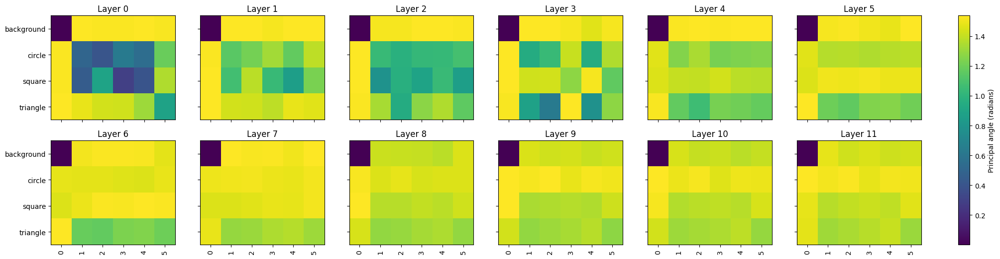

In [176]:
import math
import matplotlib.pyplot as plt

N = len(dfs_shape)
nrows = 2
ncols = math.ceil(N / nrows)

fig, axes = plt.subplots(nrows, ncols, figsize=(4 * ncols, 3 * nrows), sharex=True, sharey=True)
axes = axes.flatten()

for i, (df, ax) in enumerate(zip(dfs_shape, axes)):
    im = ax.imshow(df.values, aspect='auto')
    ax.set_title(f"Layer {i}")
    ax.set_xticks(range(len(df.columns)))
    ax.set_xticklabels(df.columns, rotation=90)
    ax.set_yticks(range(len(df.index)))
    ax.set_yticklabels(df.index)

for j in range(N, len(axes)):
    axes[j].axis('off')

cbar = fig.colorbar(im, ax=axes.tolist(), orientation='vertical', fraction=0.02, pad=0.04)
cbar.set_label("Principal angle (radians)")
plt.show()

In [177]:
# example usage:
# embeddings: np.array of shape (n_patches, dim)
# feature_labels: 1d array of length n_patches (e.g. color or shape IDs)
# object_labels:  1d array of length n_patches (object ID for each patch)
embeddings = []
for act in layered_activations:
    embeddings.append(np.concatenate(act[:, 1:, :].cpu().numpy(), axis=0))  # drop CLS token
feature_labels = np.array(colors_flat)
object_labels = np.array(object_indices_flat)
dfs_color=[]

In [178]:
for emb in embeddings:
    df_angles = analyze_subspace_angles(emb, feature_labels, object_labels, n_components=10)
    dfs_color.append(df_angles)
    print(df_angles)

                   0         1         2         3         4         5
blue    1.566461e+00  1.569504  1.554173  1.559829  1.543530  1.561247
green   1.570668e+00  1.566952  1.566415  1.560718  1.537125  1.546416
none    6.894431e-07  1.570301  1.569422  1.566591  1.566700  1.565432
purple  1.570725e+00  1.559624  1.568937  1.565050  1.540827  1.539933
red     1.570599e+00  1.553928  1.537664  1.545784  1.542652  1.533075
yellow  1.566234e+00  1.553252  1.561461  1.567632  1.564309  1.554646
                   0         1         2         3         4         5
blue    1.567627e+00  1.544862  1.542174  1.531343  1.543345  1.547647
green   1.561590e+00  1.565414  1.557077  1.546477  1.540952  1.526407
none    7.884238e-07  1.570392  1.569721  1.549671  1.559155  1.565379
purple  1.568846e+00  1.557455  1.534872  1.536266  1.558487  1.552605
red     1.570710e+00  1.559603  1.563295  1.547333  1.562089  1.544729
yellow  1.570796e+00  1.566075  1.551089  1.515646  1.530793  1.565975
      

In [179]:
for i, df in enumerate(dfs_color):
    if "none" in df.index:
        new_idx = ["none"] + [lbl for lbl in df.index if lbl != "none"]
        dfs_color[i] = df.loc[new_idx]

In [180]:
dfs_color

[                   0         1         2         3         4         5
 none    6.894431e-07  1.570301  1.569422  1.566591  1.566700  1.565432
 blue    1.566461e+00  1.569504  1.554173  1.559829  1.543530  1.561247
 green   1.570668e+00  1.566952  1.566415  1.560718  1.537125  1.546416
 purple  1.570725e+00  1.559624  1.568937  1.565050  1.540827  1.539933
 red     1.570599e+00  1.553928  1.537664  1.545784  1.542652  1.533075
 yellow  1.566234e+00  1.553252  1.561461  1.567632  1.564309  1.554646,
                    0         1         2         3         4         5
 none    7.884238e-07  1.570392  1.569721  1.549671  1.559155  1.565379
 blue    1.567627e+00  1.544862  1.542174  1.531343  1.543345  1.547647
 green   1.561590e+00  1.565414  1.557077  1.546477  1.540952  1.526407
 purple  1.568846e+00  1.557455  1.534872  1.536266  1.558487  1.552605
 red     1.570710e+00  1.559603  1.563295  1.547333  1.562089  1.544729
 yellow  1.570796e+00  1.566075  1.551089  1.515646  1.530793  

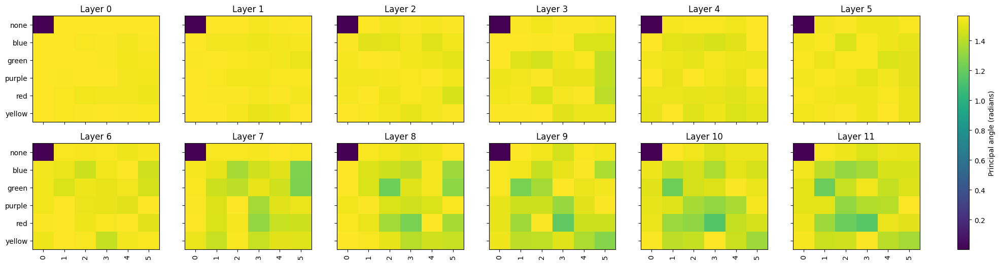

In [181]:
import math
import matplotlib.pyplot as plt

N = len(dfs_color)
nrows = 2
ncols = math.ceil(N / nrows)

fig, axes = plt.subplots(nrows, ncols, figsize=(4 * ncols, 3 * nrows), sharex=True, sharey=True)
axes = axes.flatten()

for i, (df, ax) in enumerate(zip(dfs_color, axes)):
    im = ax.imshow(df.values, aspect='auto')
    ax.set_title(f"Layer {i}")
    ax.set_xticks(range(len(df.columns)))
    ax.set_xticklabels(df.columns, rotation=90)
    ax.set_yticks(range(len(df.index)))
    ax.set_yticklabels(df.index)

for j in range(N, len(axes)):
    axes[j].axis('off')

cbar = fig.colorbar(im, ax=axes.tolist(), orientation='vertical', fraction=0.02, pad=0.04)
cbar.set_label("Principal angle (radians)")

plt.show()

In [182]:
# example usage:
# embeddings: np.array of shape (n_patches, dim)
# feature_labels: 1d array of length n_patches (e.g. color or shape IDs)
# object_labels:  1d array of length n_patches (object ID for each patch)
embeddings = []
for act in layered_activations:
    embeddings.append(np.concatenate(act[:, 1:, :].cpu().numpy(), axis=0))  # drop CLS token
feature_labels = np.array(sizes_flat)
object_labels = np.array(object_indices_flat)
dfs_size=[]

In [183]:
for emb in embeddings:
    df_angles = analyze_subspace_angles(emb, feature_labels, object_labels, n_components=5)
    dfs_size.append(df_angles)
    print(df_angles)

               0         1         2         3         4         5
0   4.007535e-07  1.570099  1.564583  1.569130  1.567075  1.563977
10  1.569337e+00  1.340901  1.103403  1.240406  1.100796  1.462021
11  1.560913e+00  1.195646  1.173030  1.501148  1.376843  1.500288
12  1.557744e+00  1.531470  1.508285  1.346037  1.190968  1.300050
13  1.564079e+00  0.765755  1.542780  1.039562  1.461210  1.502712
14  1.568927e+00  1.284205  1.500536  1.038503  1.293149  1.159032
15  1.566614e+00  0.940608  1.375519  0.567250  1.034984  1.414812
16  1.567056e+00  1.234360  1.473361  1.488026  1.472363  1.502157
17  1.568493e+00  1.420056  1.086503  1.442926  1.283335  1.430386
18  1.544765e+00  1.355545  0.840931  1.027398  1.550812  1.479461
19  1.556468e+00  1.526593  1.449666  1.526232  1.558687  1.514955
20  1.566180e+00  1.380129  0.487954  1.396839  1.247484  1.169526
21  1.562264e+00  1.513171  1.529581  1.508301  1.058403  1.406948
22  1.570210e+00  1.569551  1.074207  1.514303  1.079348  1.04

In [184]:
for i, df in enumerate(dfs_size):
    if "none" in df.index:
        new_idx = ["none"] + [lbl for lbl in df.index if lbl != "none"]
        dfs_size[i] = df.loc[new_idx]

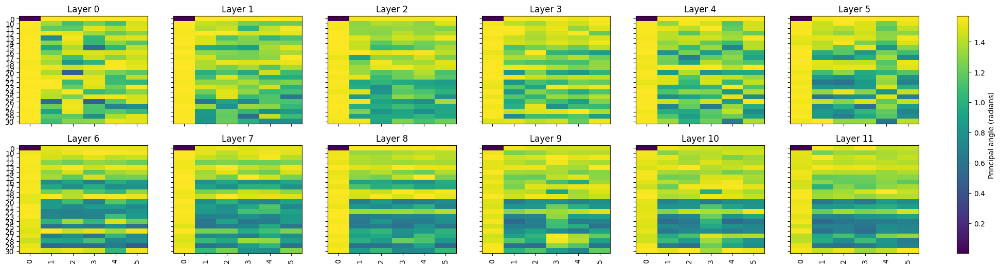

In [185]:
import math
import matplotlib.pyplot as plt

N = len(dfs_size)
nrows = 2
ncols = math.ceil(N / nrows)

fig, axes = plt.subplots(nrows, ncols, figsize=(4 * ncols, 3 * nrows), sharex=True, sharey=True)
axes = axes.flatten()

for i, (df, ax) in enumerate(zip(dfs_size, axes)):
    im = ax.imshow(df.values, aspect='auto')
    ax.set_title(f"Layer {i}")
    ax.set_xticks(range(len(df.columns)))
    ax.set_xticklabels(df.columns, rotation=90)
    ax.set_yticks(range(len(df.index)))
    ax.set_yticklabels(df.index)

for j in range(N, len(axes)):
    axes[j].axis('off')

cbar = fig.colorbar(im, ax=axes.tolist(), orientation='vertical', fraction=0.02, pad=0.04)
cbar.set_label("Principal angle (radians)")

plt.show()

In [186]:
# example usage:
# embeddings: np.array of shape (n_patches, dim)
# feature_labels: 1d array of length n_patches (e.g. color or shape IDs)
# object_labels:  1d array of length n_patches (object ID for each patch)
embeddings = []
for act in layered_activations:
    embeddings.append(np.concatenate(act[:, 1:, :].cpu().numpy(), axis=0))  # drop CLS token
feature_labels = np.array(colors_flat)
object_labels = np.array(shapes_flat)

In [187]:
dfs_shape_color=[]
for emb in embeddings:
    df_angles = analyze_subspace_angles(emb, feature_labels, object_labels, n_components=3)
    dfs_shape_color.append(df_angles)
    print(df_angles)

          background    circle    square  triangle
blue    1.570166e+00  1.537348  1.520092  1.552932
green   1.568101e+00  1.544767  1.558281  1.569373
none    3.144699e-07  1.563363  1.560403  1.569185
purple  1.566081e+00  1.565240  1.542942  1.550393
red     1.568706e+00  1.535535  1.566830  1.563295
yellow  1.565230e+00  1.546696  1.551728  1.532621
          background    circle    square  triangle
blue    1.566240e+00  1.494724  1.344063  1.405139
green   1.561037e+00  1.365011  1.240551  1.556510
none    2.872203e-07  1.562708  1.569748  1.564641
purple  1.564163e+00  1.124452  1.223713  1.415789
red     1.562013e+00  1.064058  1.514180  1.384592
yellow  1.565747e+00  1.085931  1.242748  1.427671
          background    circle    square  triangle
blue    1.569811e+00  1.047547  1.202126  0.722408
green   1.554613e+00  1.278302  1.319612  0.751019
none    1.771531e-07  1.565139  1.565467  1.558568
purple  1.542971e+00  0.954550  1.227311  0.604385
red     1.569842e+00  1.024957 

In [188]:
for i, df in enumerate(dfs_shape_color):
    if "none" in df.index:
        new_idx = ["none"] + [lbl for lbl in df.index if lbl != "none"]
        dfs_shape_color[i] = df.loc[new_idx]

In [189]:
dfs_shape_color

[          background    circle    square  triangle
 none    3.144699e-07  1.563363  1.560403  1.569185
 blue    1.570166e+00  1.537348  1.520092  1.552932
 green   1.568101e+00  1.544767  1.558281  1.569373
 purple  1.566081e+00  1.565240  1.542942  1.550393
 red     1.568706e+00  1.535535  1.566830  1.563295
 yellow  1.565230e+00  1.546696  1.551728  1.532621,
           background    circle    square  triangle
 none    2.872203e-07  1.562708  1.569748  1.564641
 blue    1.566240e+00  1.494724  1.344063  1.405139
 green   1.561037e+00  1.365011  1.240551  1.556510
 purple  1.564163e+00  1.124452  1.223713  1.415789
 red     1.562013e+00  1.064058  1.514180  1.384592
 yellow  1.565747e+00  1.085931  1.242748  1.427671,
           background    circle    square  triangle
 none    1.771531e-07  1.565139  1.565467  1.558568
 blue    1.569811e+00  1.047547  1.202126  0.722408
 green   1.554613e+00  1.278302  1.319612  0.751019
 purple  1.542971e+00  0.954550  1.227311  0.604385
 red     1

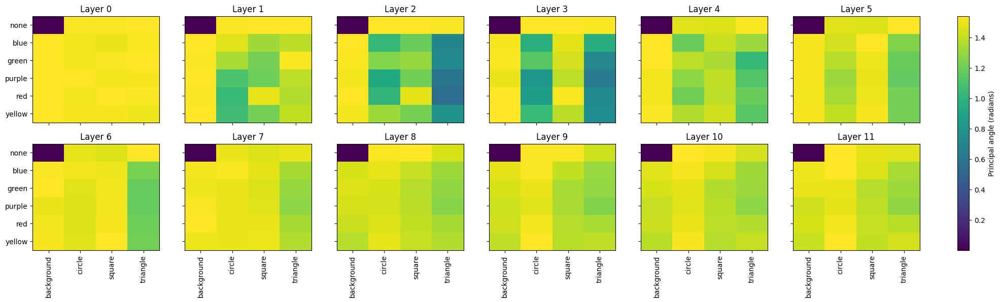

In [190]:
import math
import matplotlib.pyplot as plt

N = len(dfs_shape_color)
nrows = 2
ncols = math.ceil(N / nrows)

fig, axes = plt.subplots(nrows, ncols, figsize=(4 * ncols, 3 * nrows), sharex=True, sharey=True)
axes = axes.flatten()

for i, (df, ax) in enumerate(zip(dfs_shape_color, axes)):
    im = ax.imshow(df.values, aspect='auto')
    ax.set_title(f"Layer {i}")
    ax.set_xticks(range(len(df.columns)))
    ax.set_xticklabels(df.columns, rotation=90)
    ax.set_yticks(range(len(df.index)))
    ax.set_yticklabels(df.index)

for j in range(N, len(axes)):
    axes[j].axis('off')

cbar = fig.colorbar(im, ax=axes.tolist(), orientation='vertical', fraction=0.02, pad=0.04)
cbar.set_label("Principal angle (radians)")

plt.show()